In [1]:
import numpy as np
import pandas as pd
import scipy.cluster.hierarchy as shc
from sklearn.neighbors import NearestNeighbors
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import yellowbrick
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, kelbow_visualizer
from yellowbrick.style import set_palette
from yellowbrick.contrib.wrapper import wrap
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv("CC GENERAL.csv")
print("The shape of dataset is {}".format(df.shape))
df = df.set_index("CUST_ID")
df.head()

The shape of dataset is (8950, 18)


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
CUST_ID,,,,,,,,,,,,,,,,,
C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


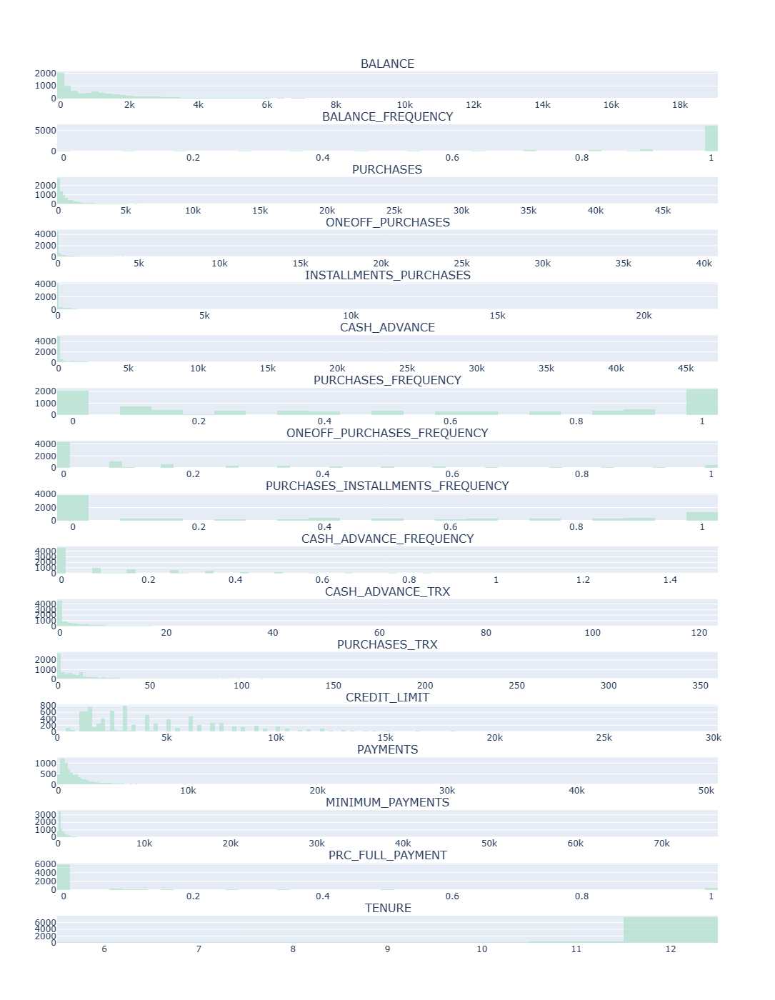

In [3]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=17, cols=1, subplot_titles=(df.columns))
for i, j in enumerate(df.columns):
    fig.append_trace(go.Histogram(x=df[j],  marker_color='#b3e2cd',opacity=0.75), i+1, 1)
    # fig.update_xaxes(title_text=j,title_font=dict(size=10), row=int(i/2)+1, col=i%2+1)
    fig.update_yaxes(nticks=3, row=int(i/2)+1, col=i%2+1)

fig.update_layout(
    showlegend=False,
    width=1000,
    height=1400
)


fig.show()

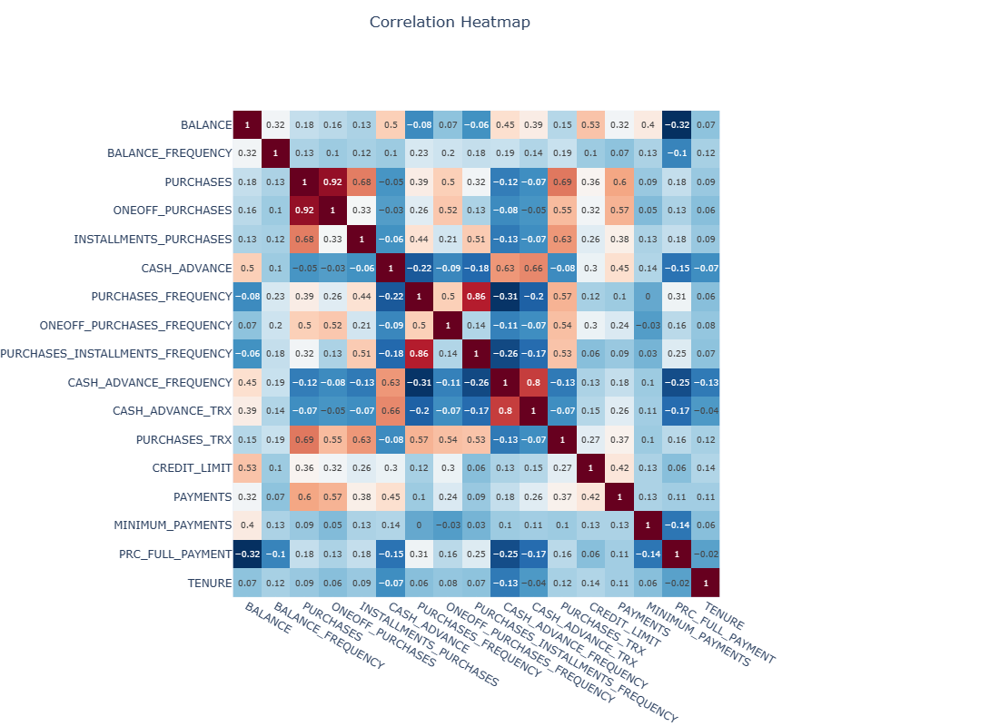

In [4]:
import plotly.express as px

fig = px.imshow(round(df.corr(), 2), color_continuous_scale='RdBu_r', text_auto=True)
fig.update_layout(title=dict(text="Correlation Heatmap",x=0.45,xanchor='center'), margin={"r":0,"t":60,"l":0,"b":0},coloraxis_showscale=False,width=1200, height=800)
fig.show()

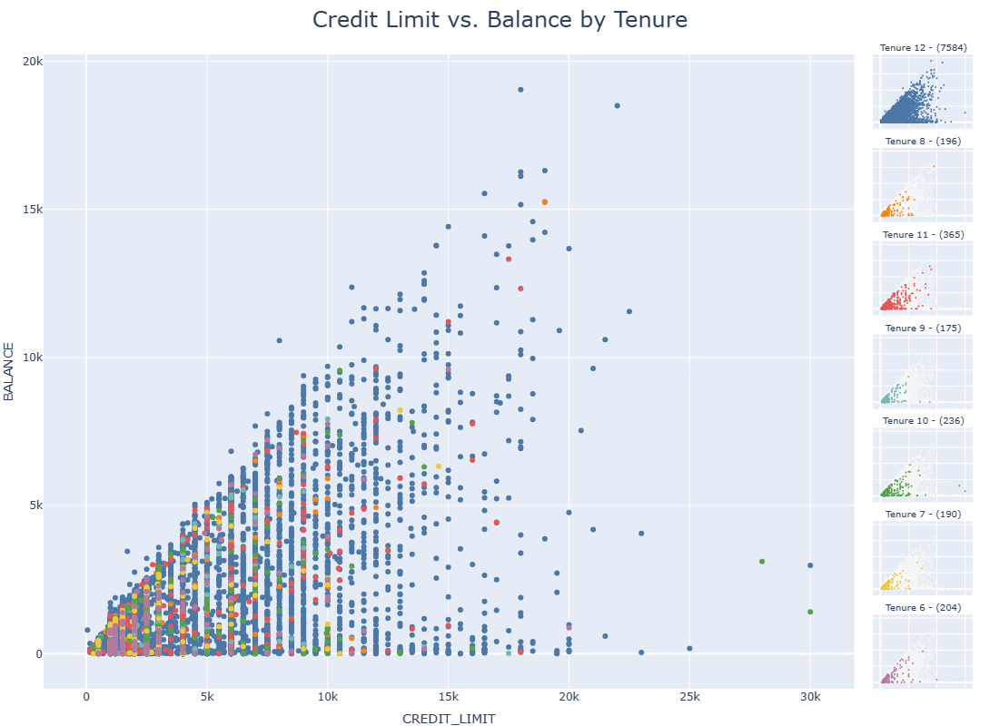

In [5]:
df.TENURE = df.TENURE.astype('object')
subtitles = [None]
for i in df.TENURE.unique():
    subtitles.append(f"Tenure {i} - ({len(df[df.TENURE==i])})") 
fig = make_subplots(rows=7, cols=8, subplot_titles=subtitles,
                    horizontal_spacing=0.02,
                    vertical_spacing=0.03,
                    specs=[[{'rowspan':7, 'colspan':7},None,None,None,None,None,None, {}],
                           [None,None,None,None,None,None,None,{}],
                           [None,None,None,None,None,None,None,{}],
                           [None,None,None,None,None,None,None,{}],
                           [None,None,None,None,None,None,None,{}],
                           [None,None,None,None,None,None,None,{}],
                           [None,None,None,None,None,None,None,{}]
                          ])
marker_colors = px.colors.qualitative.T10
for i,j in enumerate(df.TENURE.unique()):
    fig.add_trace(go.Scatter(x=df[df.TENURE==j].CREDIT_LIMIT, y=df[df.TENURE==j].BALANCE, mode='markers', marker=dict(color=marker_colors[i])),1,1)
    fig.update_xaxes(title='CREDIT_LIMIT',row=1,col=1)
    fig.update_yaxes(title='BALANCE',row=1,col=1)
    
    fig.add_trace(go.Scatter(x=df[df.TENURE!=j].CREDIT_LIMIT, y=df[df.TENURE!=j].BALANCE, mode='markers', marker=dict(size=2,color='#f5f5f5')),i+1,8)
    fig.add_trace(go.Scatter(x=df[df.TENURE==j].CREDIT_LIMIT, y=df[df.TENURE==j].BALANCE, mode='markers', marker=dict(size=2,color=marker_colors[i])),i+1,8)
    fig.update_xaxes(showticklabels=False,row=i+1,col=8)
    fig.update_yaxes(showticklabels=False,row=i+1,col=8)

fig.update_annotations(font_size=10)
fig.update_layout(title=dict(text="Credit Limit vs. Balance by Tenure", font=dict(size=24), x=0.5, xanchor='center'),
                  margin={"r":30,"t":60,"l":0,"b":0},showlegend=False,height=800)
fig.show()

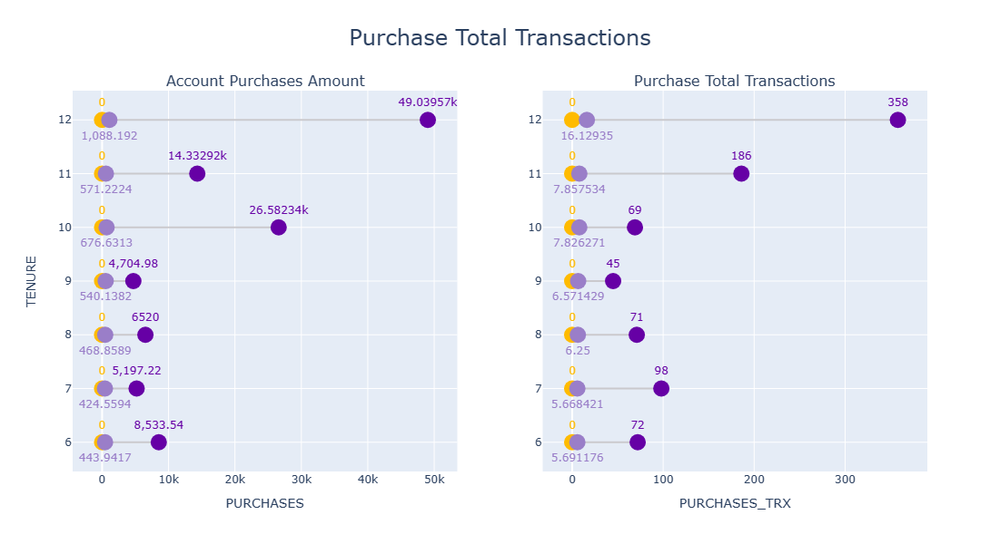

In [6]:
d1 = df[['PURCHASES', 'TENURE']]
d1 = d1.groupby('TENURE').agg(MIN=('PURCHASES', 'min'), AVG=('PURCHASES', 'mean'), MAX=('PURCHASES', 'max')).reset_index()
d2 = df[['PURCHASES_TRX', 'TENURE']]
d2 = d2.groupby('TENURE').agg(MIN=('PURCHASES_TRX', 'min'), AVG=('PURCHASES_TRX', 'mean'), MAX=('PURCHASES_TRX', 'max')).reset_index()


data1 = {"line_x": [], "line_y": [], "min": [], "max": [], "avg": []}
data2 = {"line_x": [], "line_y": [], "min": [], "max": [], "avg": []}
for i in d1.TENURE.unique():
    data1['min'].extend([d1.loc[d1.TENURE==i]['MIN'].values[0]])
    data1['max'].extend([d1.loc[d1.TENURE==i]['MAX'].values[0]])
    data1['avg'].extend([d1.loc[d1.TENURE==i]['AVG'].values[0]])
    data1['line_x'].extend([d1.loc[d1.TENURE==i]['MIN'].values[0], d1.loc[d1.TENURE==i]['MAX'].values[0], None])
    data1['line_y'].extend([i, i, None])

    data2['min'].extend([d2.loc[d2.TENURE==i]['MIN'].values[0]])
    data2['max'].extend([d2.loc[d2.TENURE==i]['MAX'].values[0]])
    data2['avg'].extend([d2.loc[d2.TENURE==i]['AVG'].values[0]])
    data2['line_x'].extend([d2.loc[d2.TENURE==i]['MIN'].values[0], d2.loc[d2.TENURE==i]['MAX'].values[0], None])
    data2['line_y'].extend([i, i, None])

fig = make_subplots(rows=1, cols=2, subplot_titles=['Account Purchases Amount', 'Purchase Total Transactions'])
fig.add_trace(go.Scatter(x=data1['line_x'], y=data1['line_y'], mode="lines", showlegend=False,  marker=dict(color="#cac9cd", line=dict(width=14))), 1, 1)
fig.add_trace(go.Scatter(x=data1['min'], y=d1.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#ffbb00"),
                         textposition="top center", showlegend=False, marker=dict(color="#ffbb00", size=18)), 1, 1)
fig.add_trace(go.Scatter(x=data1['avg'], y=d1.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#9a7ec8"),
                         textposition="bottom center", showlegend=False, marker=dict(color="#9a7ec8", size=18)), 1, 1)
fig.add_trace(go.Scatter(x=data1['max'], y=d1.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#6600a5"),
                         textposition="top center", showlegend=False, marker=dict(color="#6600a5", size=18)), 1, 1)
fig.update_xaxes(title='PURCHASES',row=1,col=1)
fig.update_yaxes(title='TENURE',row=1,col=1)

fig.add_trace(go.Scatter(x=data2['line_x'], y=data2['line_y'], mode="lines", showlegend=False,  marker=dict(color="#cac9cd", line=dict(width=14))), 1, 2)
fig.add_trace(go.Scatter(x=data2['min'], y=d2.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#ffbb00"),
                         textposition="top center", showlegend=False, marker=dict(color="#ffbb00", size=18)), 1, 2)
fig.add_trace(go.Scatter(x=data2['avg'], y=d2.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#9a7ec8"),
                         textposition="bottom center", showlegend=False, marker=dict(color="#9a7ec8", size=18)), 1, 2)
fig.add_trace(go.Scatter(x=data2['max'], y=d2.TENURE.unique(), mode="markers+text", texttemplate='%{x}', textfont=dict(color="#6600a5"),
                         textposition="top center", showlegend=False, marker=dict(color="#6600a5", size=18)), 1, 2)
fig.update_xaxes(title='PURCHASES_TRX',row=1,col=2)

fig.update_layout(title=dict(text="Purchase Total Transactions", font=dict(size=24), x=0.5, xanchor='center'),height=600)
fig.show()

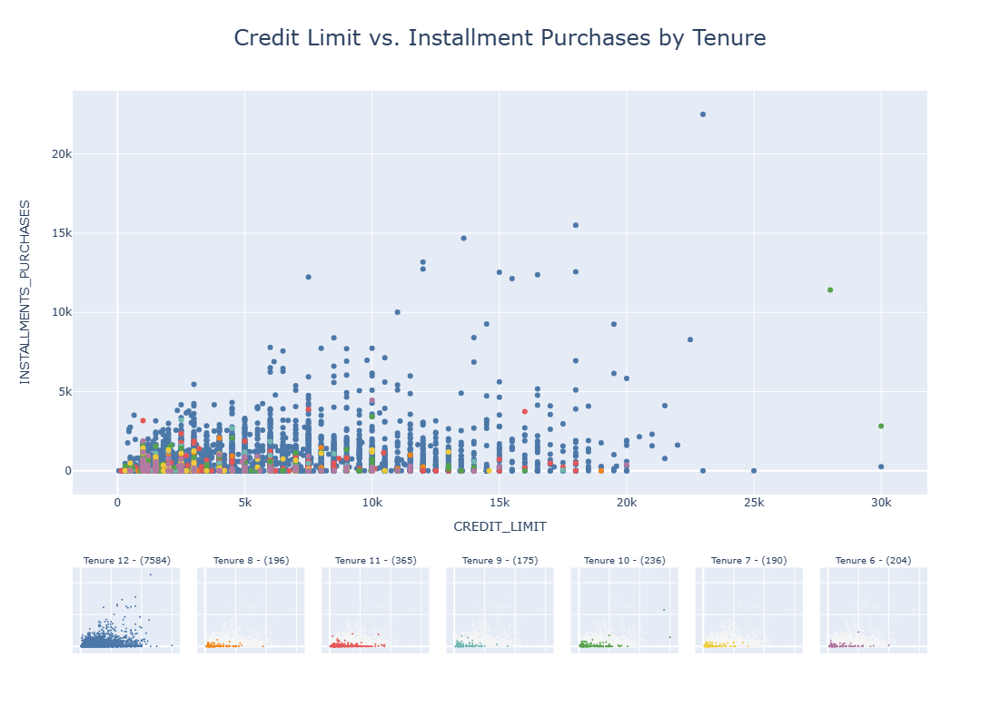

In [7]:
subtitles = [None]
for i in df.TENURE.unique():
    subtitles.append(f"Tenure {i} - ({len(df[df.TENURE==i])})") 
fig = make_subplots(rows=8, cols=7, subplot_titles=subtitles,
                    horizontal_spacing=0.02,
                    vertical_spacing=0.13,
                    specs=[[{'rowspan':6, 'colspan':7},None,None,None,None,None,None],
                           [None,None,None,None,None,None,None],
                           [None,None,None,None,None,None,None],
                           [None,None,None,None,None,None,None],
                           [None,None,None,None,None,None,None],
                           [None,None,None,None,None,None,None],
                           [{'rowspan':2},{'rowspan':2},{'rowspan':2},{'rowspan':2},{'rowspan':2},{'rowspan':2},{'rowspan':2}],
                           [None,None,None,None,None,None,None]
                          ])
marker_colors = px.colors.qualitative.T10
for i,j in enumerate(df.TENURE.unique()):
    fig.add_trace(go.Scatter(x=df[df.TENURE==j].CREDIT_LIMIT, y=df[df.TENURE==j].INSTALLMENTS_PURCHASES, mode='markers', marker=dict(color=marker_colors[i])),1,1)
    fig.update_xaxes(title='CREDIT_LIMIT',row=1,col=1)
    fig.update_yaxes(title='INSTALLMENTS_PURCHASES',row=1,col=1)
    
    fig.add_trace(go.Scatter(x=df[df.TENURE!=j].CREDIT_LIMIT, y=df[df.TENURE!=j].INSTALLMENTS_PURCHASES, mode='markers', marker=dict(size=2,color='#f5f5f5')),7,i+1)
    fig.add_trace(go.Scatter(x=df[df.TENURE==j].CREDIT_LIMIT, y=df[df.TENURE==j].INSTALLMENTS_PURCHASES, mode='markers', marker=dict(size=2,color=marker_colors[i])),7,i+1)
    fig.update_xaxes(showticklabels=False,row=7,col=i+1)
    fig.update_yaxes(showticklabels=False,row=7,col=i+1)

fig.update_annotations(font_size=10)
fig.update_layout(title=dict(text="Credit Limit vs. Installment Purchases by Tenure", font=dict(size=24), x=0.5, xanchor='center'),
                  showlegend=False,height=800)
fig.show()

In [8]:
# --- Dropping `CUST_ID` Column ---
df = df.reset_index()
# --- List Null Columns ---
null_columns = df.drop(['CUST_ID'], axis=1).columns[df.drop(['CUST_ID'], axis=1).isnull().any()].tolist()

# --- Perform Imputation ---
imputer = KNNImputer()
df_imp = pd.DataFrame(imputer.fit_transform(df[null_columns]), columns=null_columns)
df = df.fillna(df_imp)

# --- Scaling Dataset w/ Standard Scaler ---
X = pd.DataFrame(StandardScaler().fit_transform(df.drop(['CUST_ID'], axis=1)))

# --- Transform into Array ---
X = np.asarray(X)

# --- Applying PCA ---
pca = PCA(n_components=2, random_state=24)
X = pca.fit_transform(X)

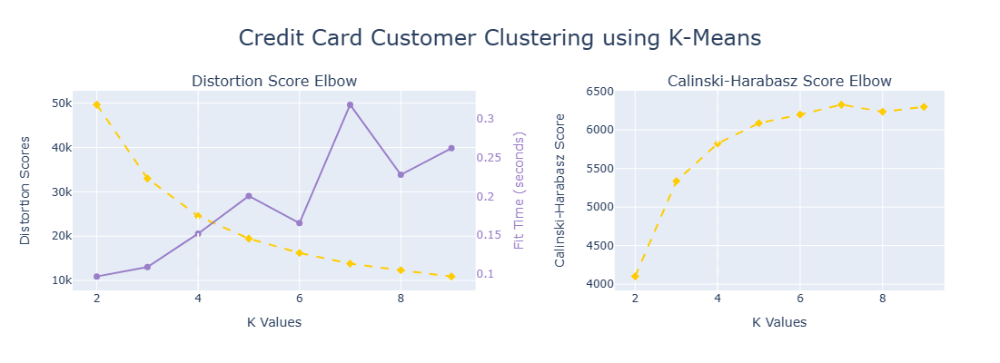

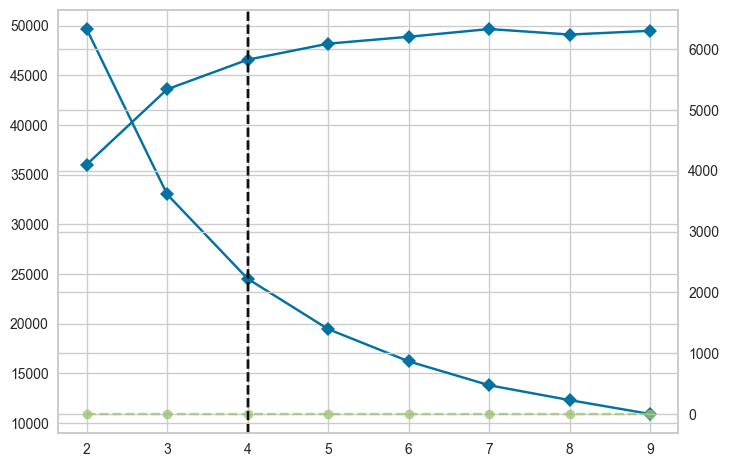

In [9]:
fig = make_subplots(rows=1, cols=2, column_widths=[0.55, 0.45],
                    specs=[[{"secondary_y": True},{}]], 
                    horizontal_spacing=0.15,
                    subplot_titles=['Distortion Score Elbow', 'Calinski-Harabasz Score Elbow'])

elbow_score = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 10))
elbow_score.fit(X)
elbow_score_ch = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 10), metric='calinski_harabasz', timings=False)
elbow_score_ch.fit(X)

fig.add_trace(go.Scatter(x=elbow_score.k_values_, y=elbow_score.k_scores_, mode="markers+lines",
                         marker=dict(color="#ffcc00", size=7, symbol='diamond'), line_dash='dash', showlegend=False), 1, 1)
fig.add_trace(go.Scatter(x=elbow_score.k_values_, y=elbow_score.k_timers_, mode="markers+lines",
                         marker=dict(color="#9a7ec8", size=7), showlegend=False), row=1, col=1, secondary_y=True)
fig.add_trace(go.Scatter(x=elbow_score_ch.k_values_, y=elbow_score_ch.k_scores_, mode="markers+lines",
                         marker=dict(color="#ffcc00", size=7, symbol='diamond'), line_dash='dash', showlegend=False), 1, 2)

fig.update_xaxes(title='K Values',row=1,col=1)
fig.update_yaxes(title='Distortion Scores',row=1,col=1)
fig.update_yaxes(title=dict(text='Fit Time (seconds)', font=dict(color="#9a7ec8")), showgrid=False, 
                 tickfont=dict(color="#9a7ec8"),row=1,col=1, secondary_y=True)
fig.add_vline(x=elbow_score.elbow_value_, line_color='#fafafa', line_dash="dash", row=1, col=1)
fig.update_xaxes(title='K Values',row=1,col=2)
fig.update_yaxes(title='Calinski-Harabasz Score',row=1,col=2)
fig.add_vline(x=elbow_score_ch.elbow_value_, line_color='#fafafa', line_dash="dash", row=1, col=2)
fig.update_layout(title=dict(text="Credit Card Customer Clustering using K-Means", font=dict(size=24), x=0.5, xanchor='center'),
                  margin={"r":0}, showlegend=False,height=400)

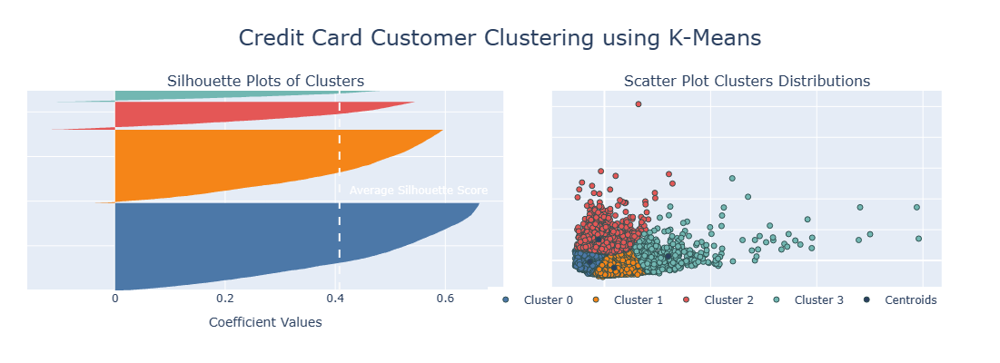

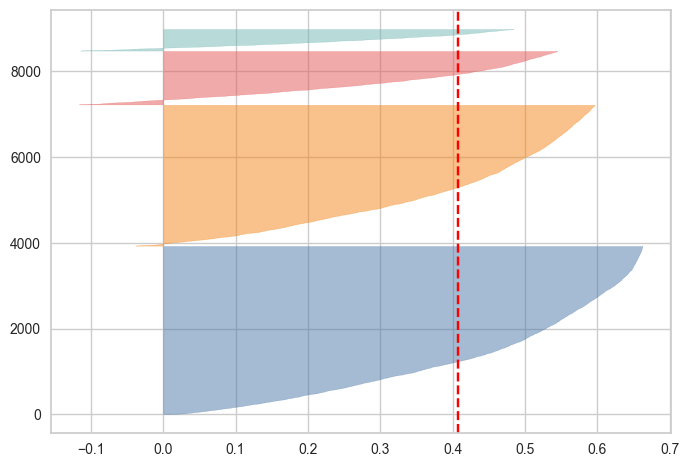

In [10]:
fig = make_subplots(rows=1, cols=2, column_widths=[0.55, 0.45],
                    specs=[[{"secondary_y": True},{}]], 
                    horizontal_spacing=0.05,
                    subplot_titles=['Silhouette Plots of Clusters', 'Scatter Plot Clusters Distributions'])

kmeans = KMeans(n_clusters=4, random_state=32, max_iter=500)
y_kmeans = kmeans.fit_predict(X)
s_viz = SilhouetteVisualizer(kmeans, colors=px.colors.qualitative.T10)
s_viz.fit(X)
cluster_colors = px.colors.qualitative.T10
kmeans_values = pd.DataFrame({"score": s_viz.silhouette_samples_, "cluster": y_kmeans}).sort_values(['cluster','score']).reset_index()
kmeans_dist = pd.concat([pd.DataFrame(X, columns=['x', 'y']), pd.DataFrame(y_kmeans, columns=["cluster"])], axis=1)
centers = s_viz.cluster_centers_

for label in range(4):
    df_imp1 = kmeans_values[kmeans_values['cluster']==label]
    df_imp2 = kmeans_dist[kmeans_dist['cluster']==label]
    fig.add_trace(go.Scatter(x=df_imp1.score,y=df_imp1.index, fill='tozerox', mode='none', orientation='h', fillcolor=cluster_colors[label],
                             textposition='middle center', text=label, showlegend=False), 1, 1)
    fig.add_trace(go.Scatter(x=df_imp2.x, y=df_imp2.y, mode="markers", 
                             marker=dict(color=cluster_colors[label], line=dict(width=1, color='DarkSlateGrey')), name=f'Cluster {label}'), 1, 2)
fig.add_trace(go.Scatter(x=s_viz.cluster_centers_[:,0], y=s_viz.cluster_centers_[:,1], mode='markers',
                    marker=dict(color='#2a3f5f', line=dict(width=1, color='DarkSlateGrey')), name='Centroids'), 1, 2)
fig.update_xaxes(title="Coefficient Values", row=1, col=1)
fig.update_yaxes(showticklabels=False, row=1, col=1)
fig.add_vline(x=s_viz.silhouette_score_, line_dash='dash', line_color='#fafafa', row=1, col=1)
fig.update_xaxes(showticklabels=False, row=1, col=2)
fig.update_yaxes(showticklabels=False, row=1, col=2)
fig.add_annotation(x=0.55,y=4500,xref="x",yref="y",text="Average Silhouette Score",showarrow=False,font=dict(color="#ffffff"), row=1, col=1)

fig.update_layout(title=dict(text="Credit Card Customer Clustering using K-Means", font=dict(size=24), x=0.5, xanchor='center'),
                  legend=dict(orientation='h', xanchor="right",x=0.94, yanchor="top", y=0.02),
                  margin={"l":30, "r":0}, height=400)

In [11]:
# --- Evaluate Clustering Quality Function ---
def evaluate_clustering(X, y):
    db_index = round(davies_bouldin_score(X, y), 3)
    s_score = round(silhouette_score(X, y), 3)
    ch_index = round(calinski_harabasz_score(X, y), 3)
    print('.: Evaluate Clustering Quality :.')
    print('*' * 34)
    print('.: Davies-Bouldin Index: ', db_index)
    print('.: Silhouette Score: ', s_score)
    print('.: Calinski Harabasz Index: ', ch_index)
    return db_index, s_score, ch_index

# --- Evaluate K-Means Cluster Quality ---
db_kmeans, ss_kmeans, ch_kmeans = evaluate_clustering(X, y_kmeans)

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.801
.: Silhouette Score:  0.408
.: Calinski Harabasz Index:  5823.676


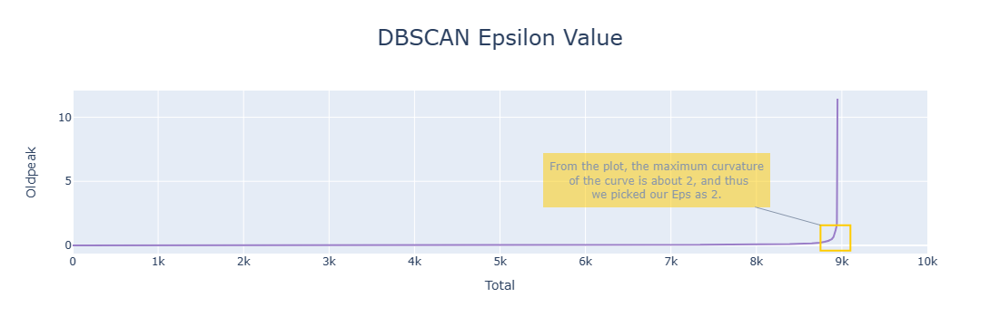

In [12]:
neighbors=NearestNeighbors(n_neighbors=2)
nbrs=neighbors.fit(X)
distances, indices=nbrs.kneighbors(X)
distances=np.sort(distances, axis = 0)

fig = go.Figure(go.Scatter(y=distances[:, 1], mode='lines', marker=dict(color='#9a7ec8')))
fig.update_xaxes(title='Total', range=[0, 10000])
fig.update_yaxes(title="Oldpeak")
fig.add_shape(type="rect",xref="x", yref="y",x0=8750, y0=-0.4, x1=9100, y1=1.58,line=dict(color="#ffcc00"),)
fig.add_annotation(x=8750,y=1.58,xref="x",yref="y",
                   text='From the plot, the maximum curvature<br> of the curve is about 2, and thus<br>we picked our Eps as 2.',
                   bgcolor="#ffcc00", opacity=0.5,showarrow=True,borderwidth=2,borderpad=6,
                   ax=-180,ay=-50)
fig.update_layout(title=dict(text="DBSCAN Epsilon Value", font=dict(size=24), x=0.5, xanchor='center'))
fig.show()

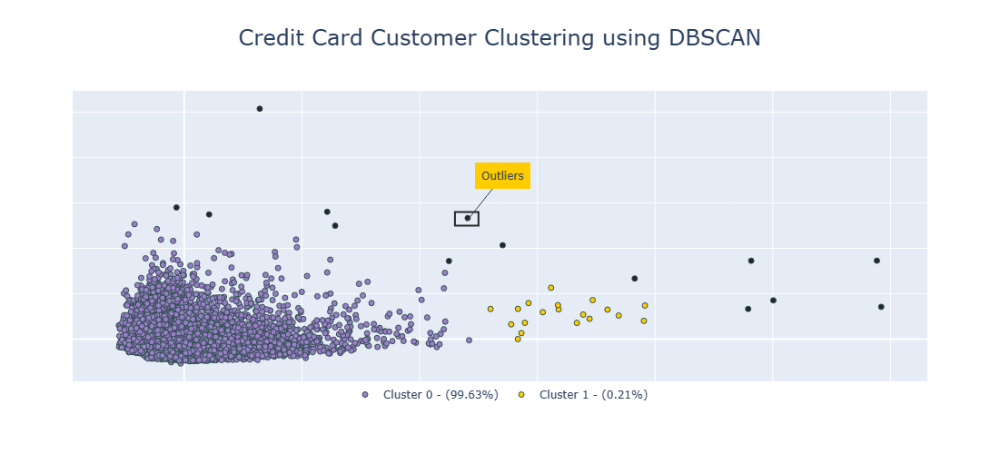

In [13]:
fig = go.Figure()

dbscan = DBSCAN(eps=2, min_samples=4)
y_dbscan = dbscan.fit_predict(X)
dbscan_dist = pd.concat([pd.DataFrame(X, columns=['x', 'y']), pd.DataFrame(y_dbscan, columns=["cluster"])], axis=1)
cluster_colors = ['#9a7ec8', '#ffcc00']

for label in range(2):
    df_imp = dbscan_dist[dbscan_dist['cluster']==label]
    fig.add_trace(go.Scatter(x=df_imp.x, y=df_imp.y, mode="markers", 
                             marker=dict(color=cluster_colors[label], line=dict(width=1, color='DarkSlateGrey')), 
                             name=f'Cluster {label} - ({round(df_imp.shape[0]/dbscan_dist.shape[0]*100, 2)}%)'))
fig.add_trace(go.Scatter(x=dbscan_dist[dbscan_dist['cluster']==-1].x, y=dbscan_dist[dbscan_dist['cluster']==-1].y, mode="markers", 
                             marker=dict(color='#262626', line=dict(width=1, color='DarkSlateGrey')), showlegend=False))
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.add_shape(type="rect",xref="x", yref="y",x0=11.5, y0=12.5, x1=12.5, y1=14,line=dict(color="#262626"))
fig.add_annotation(x=12,y=13,xref="x",yref="y",
                   text='Outliers',
                   bgcolor="#ffcc00",showarrow=True,borderwidth=2,borderpad=6,
                   ax=40,ay=-50)
fig.update_layout(title=dict(text="Credit Card Customer Clustering using DBSCAN", font=dict(size=24), x=0.5, xanchor='center'),
                  legend=dict(orientation='h', xanchor="center",x=0.5, yanchor='top', y=0.0), height=500)

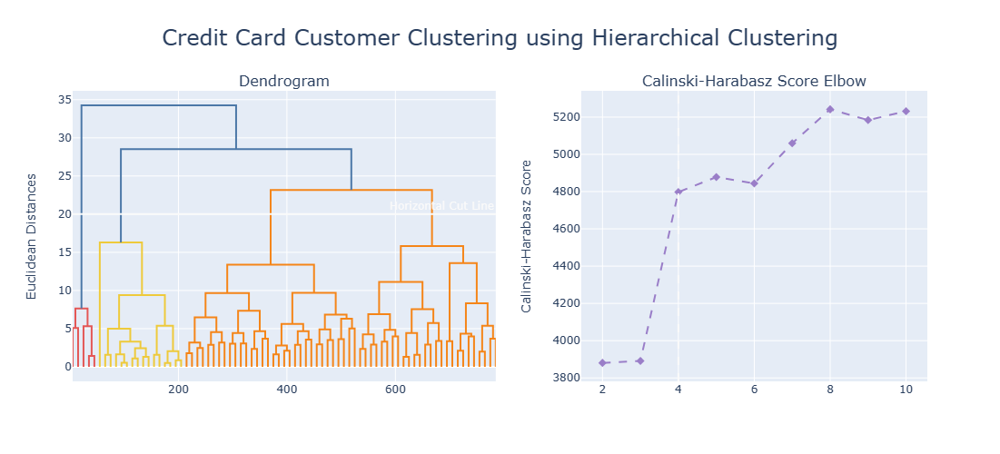

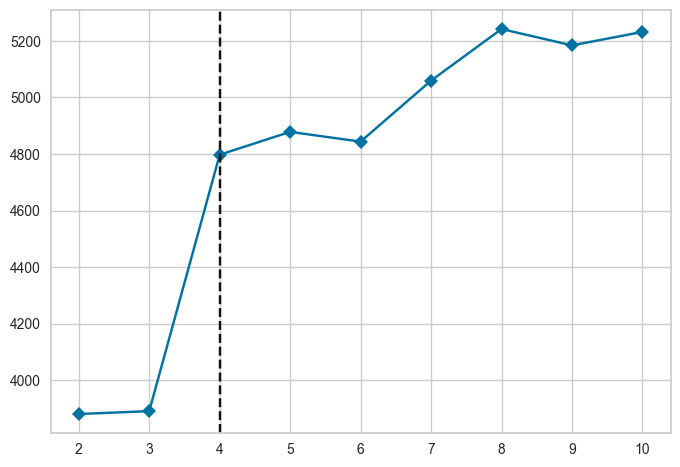

In [14]:
from modified_dendrogram import create_dendrogram

fig = make_subplots(rows=1, cols=2, column_widths=[0.55, 0.45],
                    subplot_titles=['Dendrogram', 'Calinski-Harabasz Score Elbow'])

elbow_score_ch = KElbowVisualizer(AgglomerativeClustering(), metric='calinski_harabasz', timings=False)
elbow_score_ch.fit(X)

dent = create_dendrogram(X, colorscale = px.colors.qualitative.T10, truncate_mode="level", p=7)
for i in dent['data']:
    fig.add_trace(i, 1, 1)
fig.add_trace(go.Scatter(x=elbow_score_ch.k_values_, y=elbow_score_ch.k_scores_, mode="markers+lines",
                         marker=dict(color="#9a7ec8", size=7, symbol='diamond'), line_dash='dash'), 1, 2)

fig.update_yaxes(title='Euclidean Distances\n', row=1, col=1)
fig.update_yaxes(title='Calinski-Harabasz Score\n', row=1, col=2)
fig.add_hline(y=20, line_color='#fafafa', annotation_text="Horizontal Cut Line", 
              annotation_position="top right", annotation_font_color="#fafafa", row=1, col=1)
fig.add_vline(x=elbow_score_ch.elbow_value_, line_color='#fafafa', line_dash="dash", row=1, col=2)

fig.update_layout(title=dict(text="Credit Card Customer Clustering using Hierarchical Clustering", font=dict(size=24), x=0.5, xanchor='center'),
                  height=500, showlegend=False)

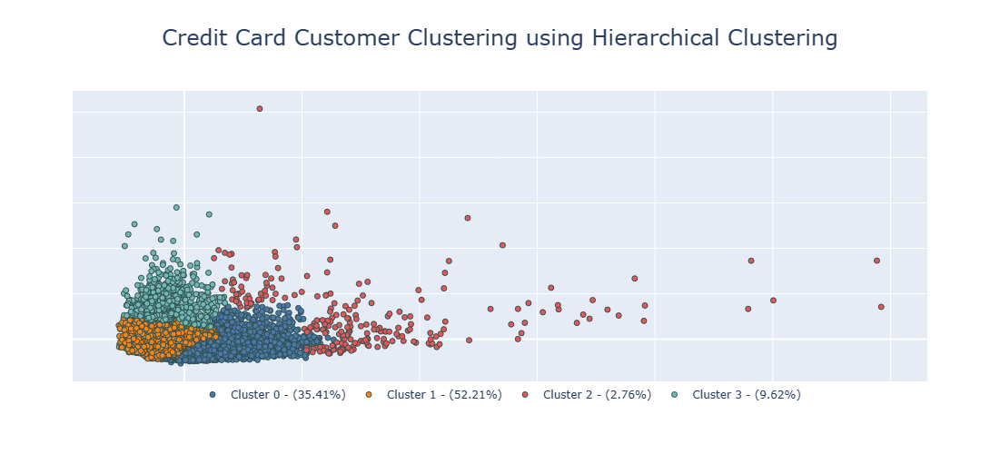

In [15]:
fig = go.Figure()

agg_cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
y_agg_cluster = agg_cluster.fit_predict(X)
agg_cluster_dist = pd.concat([pd.DataFrame(X, columns=['x', 'y']), pd.DataFrame(y_agg_cluster, columns=["cluster"])], axis=1)
cluster_colors = px.colors.qualitative.T10

for label in range(len(agg_cluster_dist.cluster.unique())):
    df_imp = agg_cluster_dist[agg_cluster_dist['cluster']==label]
    fig.add_trace(go.Scatter(x=df_imp.x, y=df_imp.y, mode="markers", 
                             marker=dict(color=cluster_colors[label], line=dict(width=1, color='DarkSlateGrey')), 
                             name=f'Cluster {label} - ({round(df_imp.shape[0]/agg_cluster_dist.shape[0]*100, 2)}%)'))
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)

fig.update_layout(title=dict(text="Credit Card Customer Clustering using Hierarchical Clustering", font=dict(size=24), x=0.5, xanchor='center'),
                  legend=dict(orientation='h', xanchor="center",x=0.5, yanchor='top', y=0.0), height=500)

In [16]:
# compare = pd.DataFrame({'Model': ['K-Means', 'DBSCAN', 'Hierarchical Clustering'], 
#                         'Davies-Bouldin Index-': [0.801000, 0.408000, 5823.676000],
#                         'Silhouette Score+': [1.287000, 0.803000, 685.303000],
#                        'Calinski-Harabasz Index+': [0.863000, 0.388000, 4797.510000]})
compare = pd.DataFrame()
# compare['scores'] = ['Davies-Bouldin Index-','Silhouette Score+','Calinski-Harabasz Index+']
compare['K-Means'] = [0.801000, 0.408000, 5823.676000]
compare['DBSCAN'] = [1.287000, 0.803000, 685.303000]
compare['Hierarchical Clustering'] = [0.863000, 0.388000, 4797.510000]
def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]

compare = compare.T.reset_index()
compare.columns = ['Model','Davies-Bouldin Index-','Silhouette Score+','Calinski-Harabasz Index+']
compare.style.hide().apply(highlight_max, subset=['Davies-Bouldin Index-','Silhouette Score+','Calinski-Harabasz Index+'])

Model,Davies-Bouldin Index-,Silhouette Score+,Calinski-Harabasz Index+
K-Means,0.801000,0.408000,5823.676000
DBSCAN,1.287000,0.803000,685.303000
Hierarchical Clustering,0.863000,0.388000,4797.510000


In [31]:
kmeans = KMeans(n_clusters=4, random_state=32, max_iter=500)
y_kmeans = kmeans.fit_predict(X)
df_clustered = df.copy(deep=True)
df_clustered['cluster_result'] = y_kmeans+1
df_clustered['cluster_result'] = 'Cluster '+df_clustered['cluster_result'].astype(str)

# --- Calculationg Overall Mean from Current Data Frame ---
df_profile_overall = pd.DataFrame()
df_profile_overall['Overall'] = df_clustered.describe().loc[['mean']].T

# --- Summarize Mean of Each Clusters --- 
df_cluster_summary = df_clustered.groupby('cluster_result').describe().T.reset_index().rename(columns={'level_0': 'Column Name', 'level_1': 'Metrics'})
df_cluster_summary = df_cluster_summary[df_cluster_summary['Metrics'] == 'mean'].set_index('Column Name')

# --- Combining Both Data Frame ---
print('.: Summarize of Each Clusters :.')
print('*' * 33)
df_profile = df_cluster_summary.join(df_profile_overall)
df_profile.style.background_gradient(cmap='YlOrBr')

.: Summarize of Each Clusters :.
*********************************


,Metrics,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Overall
Column Name,,,,,,
BALANCE,mean,3401.840056,1012.915503,824.180354,4510.612798,1564.474828
BALANCE_FREQUENCY,mean,0.988427,0.799792,0.919997,0.963486,0.877271
PURCHASES,mean,6894.613917,223.081279,1236.499406,462.647357,1003.204834
ONEOFF_PURCHASES,mean,4511.889901,157.576608,621.738764,300.127390,592.437371
INSTALLMENTS_PURCHASES,mean,2383.916859,65.833785,614.965725,162.619301,411.067645
CASH_ADVANCE,mean,773.154467,614.588758,147.442197,4401.478579,978.871112
PURCHASES_FREQUENCY,mean,0.954443,0.190099,0.862440,0.266258,0.490351
ONEOFF_PURCHASES_FREQUENCY,mean,0.726667,0.074901,0.301883,0.129829,0.202458
PURCHASES_INSTALLMENTS_FREQUENCY,mean,0.808946,0.109962,0.675116,0.166187,0.364437


In [32]:
df_clustered

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster_result
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,Cluster 2
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,Cluster 4
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,Cluster 3
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,1215.951453,0.000000,12,Cluster 2
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,Cluster 2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,Cluster 3
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,3720.379789,0.000000,6,Cluster 3
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,Cluster 2
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,Cluster 2


In [38]:
round(len(df_clustered[df_clustered.cluster_result == 'Cluster 1'])/len(df_clustered)*100, 2)

5.62

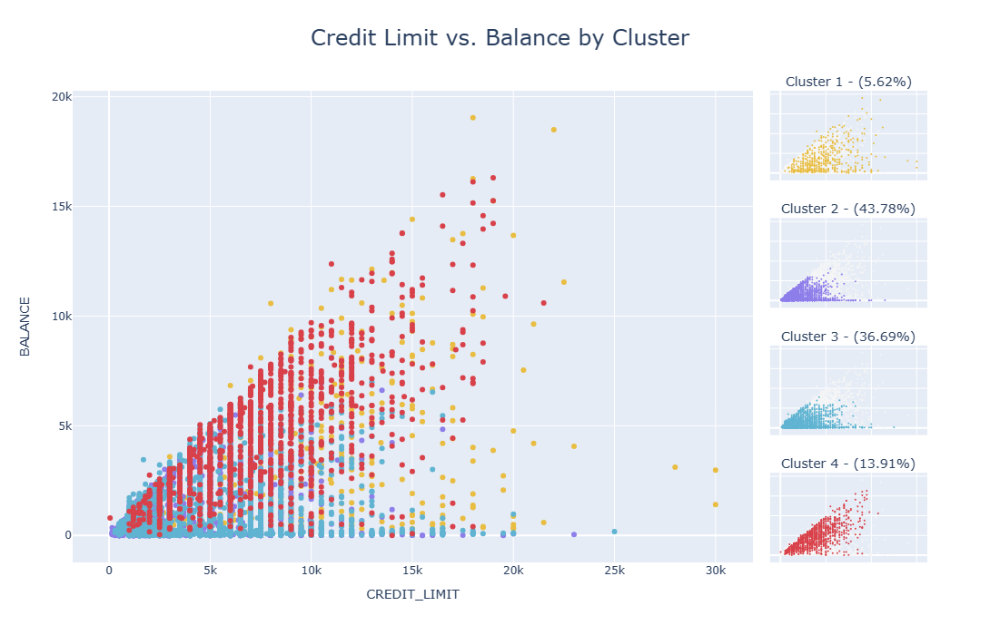

In [40]:
subtitles = [None]
for i in ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']:
    subtitles.append(f"{i} - ({round(len(df_clustered[df_clustered.cluster_result == i])/len(df_clustered)*100, 2)}%)")
fig = make_subplots(rows=4, cols=5, subplot_titles=subtitles,
                    horizontal_spacing=0.02,
                    vertical_spacing=0.08,
                    specs=[[{'rowspan': 4, 'colspan': 4}, None, None, None, {}],
                           [None, None, None, None, {}],
                           [None, None, None, None, {}],
                           [None, None, None, None, {}],
                          ])
marker_colors = ['#e8bd42', '#8d7ee9', '#60b4d2', '#d8414a']
for i, j in enumerate(['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']):
    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result == j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result == j].BALANCE, mode='markers',
                             marker=dict(color=marker_colors[i])), 1, 1)
    fig.update_xaxes(title='CREDIT_LIMIT',title_font=dict(size=20), row=1, col=1)
    fig.update_yaxes(title='BALANCE',title_font=dict(size=20), row=1, col=1)

    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result != j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result != j].BALANCE, mode='markers',
                             marker=dict(size=2, color='#f5f5f5')), i+1, 5)
    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result == j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result == j].BALANCE, mode='markers',
                             marker=dict(size=2, color=marker_colors[i])), i+1, 5)
    fig.update_xaxes(showticklabels=False, row=i + 1, col=5)
    fig.update_yaxes(showticklabels=False, row=i + 1, col=5)

fig.update_annotations(font_size=14)
fig.update_layout(title=dict(text="Credit Limit vs. Balance by Cluster", font=dict(size=24), x=0.5, xanchor='center'),
                  showlegend=False, height=700)

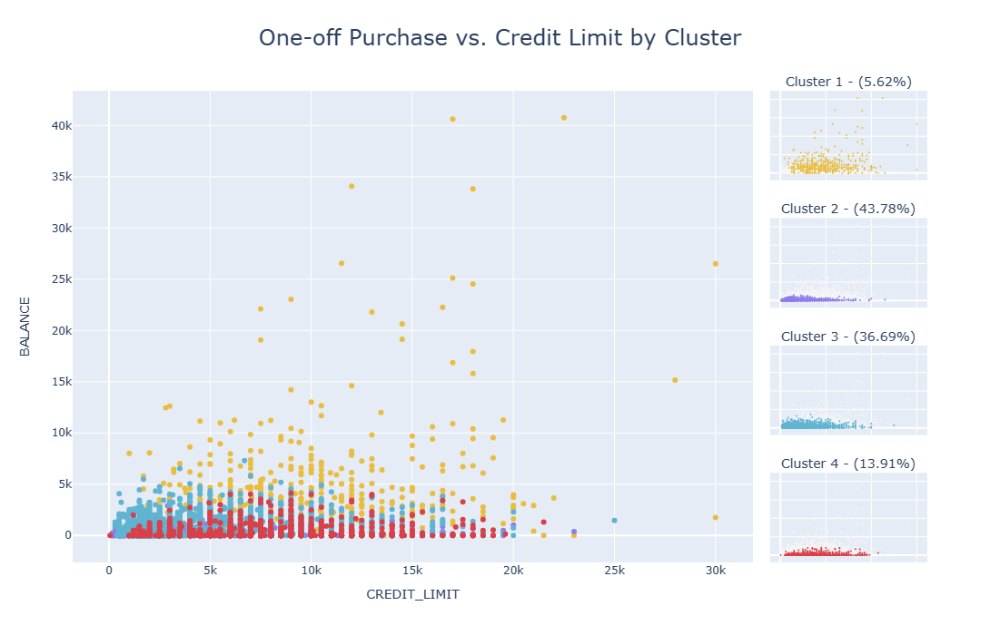

In [41]:
subtitles = [None]
for i in ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']:
    subtitles.append(f"{i} - ({round(len(df_clustered[df_clustered.cluster_result == i])/len(df_clustered)*100, 2)}%)")
fig = make_subplots(rows=4, cols=5, subplot_titles=subtitles,
                    horizontal_spacing=0.02,
                    vertical_spacing=0.08,
                    specs=[[{'rowspan': 4, 'colspan': 4}, None, None, None, {}],
                           [None, None, None, None, {}],
                           [None, None, None, None, {}],
                           [None, None, None, None, {}],
                          ])
marker_colors = ['#e8bd42', '#8d7ee9', '#60b4d2', '#d8414a']
for i, j in enumerate(['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']):
    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result == j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result == j].ONEOFF_PURCHASES, mode='markers',
                             marker=dict(color=marker_colors[i])), 1, 1)
    fig.update_xaxes(title='CREDIT_LIMIT',title_font=dict(size=20), row=1, col=1)
    fig.update_yaxes(title='BALANCE',title_font=dict(size=20), row=1, col=1)

    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result != j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result != j].ONEOFF_PURCHASES, mode='markers',
                             marker=dict(size=2, color='#f5f5f5')), i+1, 5)
    fig.add_trace(go.Scatter(x=df_clustered[df_clustered.cluster_result == j].CREDIT_LIMIT, 
                             y=df_clustered[df_clustered.cluster_result == j].ONEOFF_PURCHASES, mode='markers',
                             marker=dict(size=2, color=marker_colors[i])), i+1, 5)
    fig.update_xaxes(showticklabels=False, row=i + 1, col=5)
    fig.update_yaxes(showticklabels=False, row=i + 1, col=5)

fig.update_annotations(font_size=14)
fig.update_layout(title=dict(text="One-off Purchase vs. Credit Limit by Cluster", font=dict(size=24), x=0.5, xanchor='center'),
                  showlegend=False, height=700)

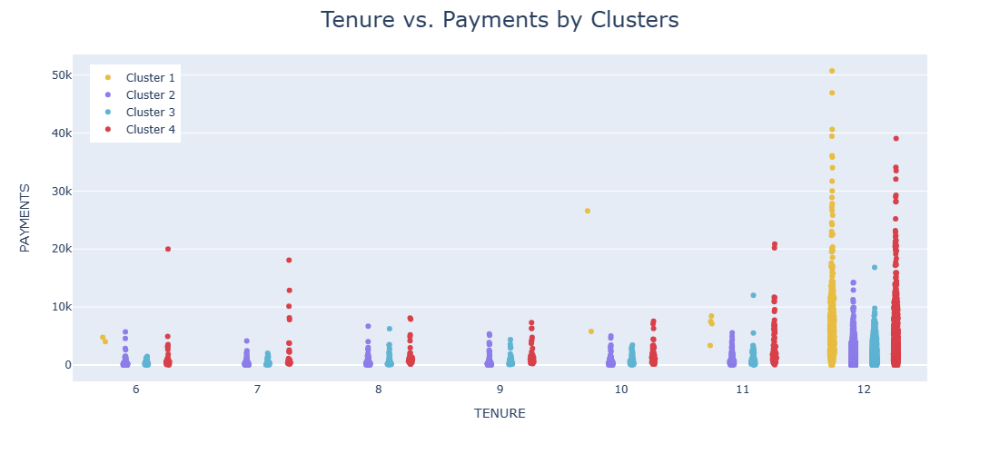

In [72]:
fig = px.strip(df_clustered.sort_values('cluster_result'), x="TENURE", y="PAYMENTS", color='cluster_result', color_discrete_sequence=marker_colors)
fig.update_layout(title=dict(text="Tenure vs. Payments by Clusters", font=dict(size=24), x=0.5, xanchor='center'),
                  legend=dict(title='', xanchor="left",x=0.02, yanchor='top', y=0.97), height=500)